# Customer Behavior Based Clustering
* I remind of one of my past projects about Customer Behavior Based Clustering
* Original codes were written in Pyspark(because of huge dataset size), but this tutorial code is written in python
<br/><br/>
* To indentify types of customers with mobile log behaviors
* Unlike RFM segmentation, it is important to find the direction of customers' mobile log behaviors
* The key of clustering is using cosine similarities among customers mobile log behaviors

In [1]:
import pandas as pd
import numpy as np
from pandas import DataFrame, Series
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
import scipy.cluster.hierarchy as sch
import os
import re
import gc


In [2]:
### Read File

folder = './data/'
file_path = folder + 'bhv_dataset_raw.pkl'
df = pd.read_pickle(file_path)


# The Shape of Dataset
* As you can see, this dataset is a kind of stacked mobile logs (3 months)
<br/><br/>
* Columns are
1. customer_id : Customers' indentification numbers
2. date_id : Dates that customers act in mobile app behavior (Such like "Click search button", "Order finish", etc)
3. session_id : Log-in sessions
4. bhr_seq : The order of behaviors in each sequences
5. bhr_cd : mobile app behavior (Such like "Click search button", "Order finish", etc)
<br/><br/>
* This dataset is not real one 😉

In [3]:
### DataFrame Information

df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27930062 entries, 0 to 27930061
Data columns (total 5 columns):
 #   Column       Dtype         
---  ------       -----         
 0   customer_id  int32         
 1   date_id      datetime64[ns]
 2   session_id   object        
 3   bhr_seq      int32         
 4   bhr_cd       int32         
dtypes: datetime64[ns](1), int32(3), object(1)
memory usage: 745.8+ MB


In [4]:
### DataFrame Example

df.head(15)


,customer_id,date_id,session_id,bhr_seq,bhr_cd
0,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,1,1552581
1,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,2,1542671
2,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,3,4553170
3,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,4,3542568
4,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,5,3542568
5,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,6,1552870
6,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,7,1572668
7,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,8,2542568
8,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,9,2542569
9,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,10,2542570


# "Order Finish" Behavior in Sessions
* Some Sessions have multiple "Order Finish" Behaviors
* In this Clustering, I will split the session that has multiple "Order Finish" Behaviors into multiple sessions that has single "Order Finish" Behavior

In [5]:
### How Many "Order Finish" Mobile Behavior Does Each Session IDs Contains ? ###
### Flag "Order Finish"(Code: 2542570)

df['ord_seq'] = df['bhr_cd'].where(df['bhr_cd'] == 2542570, np.nan)
df['ord_seq'] = df['ord_seq'].where(df['ord_seq'].isnull(), 1)
df.head(15)


,customer_id,date_id,session_id,bhr_seq,bhr_cd,ord_seq
0,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,1,1552581,NaN
1,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,2,1542671,NaN
2,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,3,4553170,NaN
3,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,4,3542568,NaN
4,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,5,3542568,NaN
5,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,6,1552870,NaN
6,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,7,1572668,NaN
7,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,8,2542568,NaN
8,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,9,2542569,NaN
9,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,10,2542570,1.0


In [6]:
### Aggregate The Count of "Order Finish" By Session ID Level

df_agg_of = df.groupby(['session_id']).agg({'ord_seq':'count'})
df_agg_of.sort_values(['ord_seq'], ascending=[False])


,ord_seq
session_id,
1901273743912396115953216268324493QONcxLLrCH,70
1901273743912396115956837785099922EHGyLpBCrE,56
1903283745425770121151532417264603apUdDbuVW6,24
1903242109665722120748230874948178PWoJ9lVzLP,22
1901273743912466115945935715160339HEUSy4kq1J,21
...,...
1902021954218275116478687765024643ECz9VttR5q,1
1902021954228791116475087262741704gMHZkRDPZZ,1
1902021954234934116500527978482108w9ZGNqfJaB,1


In [7]:
### Splite Session ID By Order Finish Code

df['ord_seq'] = df['bhr_seq'] + df['ord_seq']
df.head(20)


,customer_id,date_id,session_id,bhr_seq,bhr_cd,ord_seq
0,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,1,1552581,NaN
1,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,2,1542671,NaN
2,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,3,4553170,NaN
3,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,4,3542568,NaN
4,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,5,3542568,NaN
5,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,6,1552870,NaN
6,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,7,1572668,NaN
7,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,8,2542568,NaN
8,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,9,2542569,NaN
9,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,10,2542570,11.0


In [8]:
df['ord_seq_1'] = df.groupby(['session_id'])['ord_seq'].fillna(method='bfill')
df['ord_seq_1'].fillna(10000, inplace=True)
df.head(20)


,customer_id,date_id,session_id,bhr_seq,bhr_cd,ord_seq,ord_seq_1
0,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,1,1552581,NaN,11.0
1,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,2,1542671,NaN,11.0
2,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,3,4553170,NaN,11.0
3,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,4,3542568,NaN,11.0
4,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,5,3542568,NaN,11.0
5,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,6,1552870,NaN,11.0
6,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,7,1572668,NaN,11.0
7,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,8,2542568,NaN,11.0
8,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,9,2542569,NaN,11.0
9,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,10,2542570,11.0,11.0


In [9]:
df['ord_seq_1'] = df['ord_seq_1'].astype(int).astype(str)
df['ord_seq_1'] = df['ord_seq_1'].str.pad(5, side ='left', fillchar ='0')
df.head(20)


,customer_id,date_id,session_id,bhr_seq,bhr_cd,ord_seq,ord_seq_1
0,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,1,1552581,NaN,00011
1,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,2,1542671,NaN,00011
2,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,3,4553170,NaN,00011
3,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,4,3542568,NaN,00011
4,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,5,3542568,NaN,00011
5,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,6,1552870,NaN,00011
6,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,7,1572668,NaN,00011
7,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,8,2542568,NaN,00011
8,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,9,2542569,NaN,00011
9,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,10,2542570,11.0,00011


# "Order Finish" Behavior in Sessions
* Finally, I got multiple "Order Finish" Behaviors into multiple sessions that has single "Order Finish" Behavior

In [10]:
df['session_id_new'] = df['session_id'] + '_' + df['ord_seq_1']
df.head(20)


,customer_id,date_id,session_id,bhr_seq,bhr_cd,ord_seq,ord_seq_1,session_id_new
0,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,1,1552581,NaN,00011,1901123743915219114657181549906889BWD3csWxSW_0...
1,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,2,1542671,NaN,00011,1901123743915219114657181549906889BWD3csWxSW_0...
2,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,3,4553170,NaN,00011,1901123743915219114657181549906889BWD3csWxSW_0...
3,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,4,3542568,NaN,00011,1901123743915219114657181549906889BWD3csWxSW_0...
4,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,5,3542568,NaN,00011,1901123743915219114657181549906889BWD3csWxSW_0...
5,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,6,1552870,NaN,00011,1901123743915219114657181549906889BWD3csWxSW_0...
6,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,7,1572668,NaN,00011,1901123743915219114657181549906889BWD3csWxSW_0...
7,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,8,2542568,NaN,00011,1901123743915219114657181549906889BWD3csWxSW_0...
8,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,9,2542569,NaN,00011,1901123743915219114657181549906889BWD3csWxSW_0...
9,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW,10,2542570,11.0,00011,1901123743915219114657181549906889BWD3csWxSW_0...


In [11]:
df.loc[0, 'session_id_new']


'1901123743915219114657181549906889BWD3csWxSW_00011'

In [12]:
### Rename & Tidy-Up Columns

df.drop(['session_id', 'ord_seq', 'ord_seq_1'], axis=1, inplace=True)
df.rename(columns={'session_id_new':'session_id'}, inplace=True)
df = df[['customer_id', 'date_id', 'session_id', 'bhr_seq', 'bhr_cd']]
df.head(20)


,customer_id,date_id,session_id,bhr_seq,bhr_cd
0,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW_0...,1,1552581
1,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW_0...,2,1542671
2,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW_0...,3,4553170
3,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW_0...,4,3542568
4,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW_0...,5,3542568
5,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW_0...,6,1552870
6,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW_0...,7,1572668
7,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW_0...,8,2542568
8,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW_0...,9,2542569
9,1732476,2019-01-12,1901123743915219114657181549906889BWD3csWxSW_0...,10,2542570


# Multiple Behaviors in Sessions
* There are very often behaviors like "Searh" & "product click", etc
* Due to high behavior counts, it make a bad impact on clustering process (It could make up for the most of clustering explanation)
* Instead, drop multiple behaviors in sessions (eg: In 1 seesion, 5 product clicks -> 1 product click)

In [13]:
### Aggregate Behavior Data By Customer IDs

cols = ['customer_id', 'bhr_cd']
df_agg_cust = df.groupby(cols).agg({'bhr_seq':'count'})
df_agg_cust.head(20)


bhr_seq
customer_id bhr_cd          
1732476     1542670        1
            1542671        4
            1552569        2
            1552573        2
            1552581        6
            1552870        3
            1562568        1
            1562670        1
            1572668        8
            1572670        1
            2542568        4
            2542569        4
            2542570        4
            3542568        3
            4552872        1
            4553170        4
1732496     1542671        5
            1552569        7
            1552573        6
            1552576        7

In [14]:
### Aggregate Behavior Data By Customer IDs w/o No Duplicated Behaviors in Sessions

df_no_duplicated = df.drop_duplicates(['session_id', 'bhr_cd'])
df_agg_cust_no = df_no_duplicated.groupby(cols).agg({'bhr_seq':'count'})
df_agg_cust_no.head(20)


bhr_seq
customer_id bhr_cd          
1732476     1542670        1
            1542671        4
            1552569        2
            1552573        1
            1552581        4
            1552870        3
            1562568        1
            1562670        1
            1572668        4
            1572670        1
            2542568        3
            2542569        4
            2542570        4
            3542568        2
            4552872        1
            4553170        3
1732496     1542671        4
            1552569        4
            1552573        3
            1552576        5

In [15]:
df_agg_cust.reset_index(inplace=True)
df_agg_cust_no.reset_index(inplace=True)
df_agg_cust['duplicated'] = 1
df_agg_cust_no['duplicated'] = 0
df_agg_total = df_agg_cust.append(df_agg_cust_no).reset_index(drop=True)


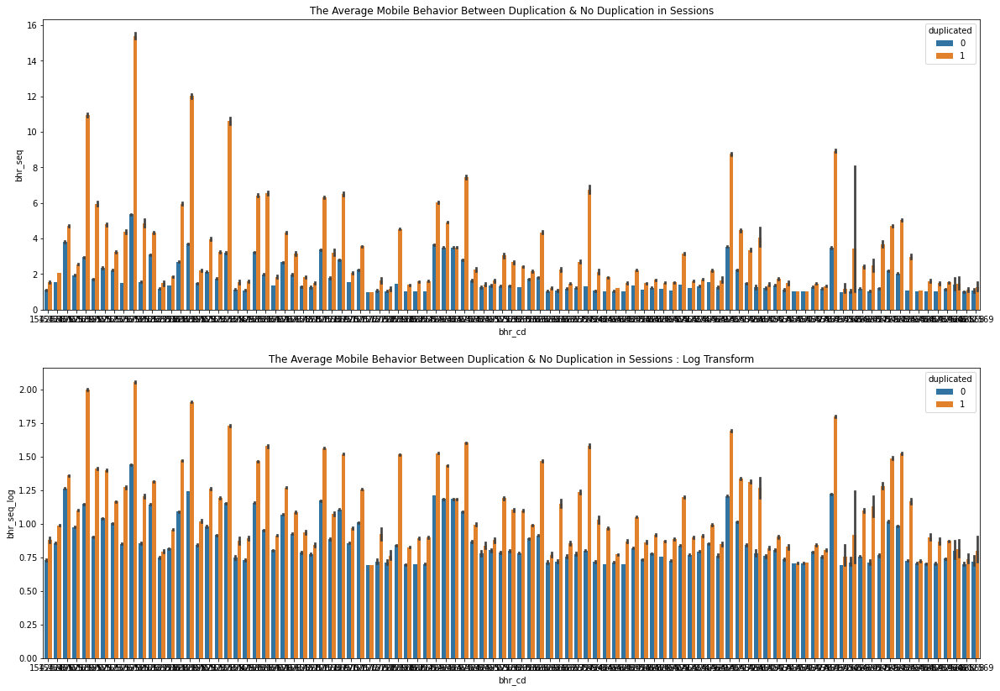

In [16]:
### The Average Mobile Behavior Between Duplication & No Duplication in Sessions

df_agg_total['bhr_seq_log'] = np.log(df_agg_total['bhr_seq'] + 1)
fig, ax = plt.subplots(2, 1, figsize=(20, 14))
sns.barplot(data=df_agg_total, x='bhr_cd', y='bhr_seq', hue='duplicated', ax=ax[0])
ax[0].set_title('The Average Mobile Behavior Between Duplication & No Duplication in Sessions')
sns.barplot(data=df_agg_total, x='bhr_cd', y='bhr_seq_log', hue='duplicated', ax=ax[1])
ax[1].set_title('The Average Mobile Behavior Between Duplication & No Duplication in Sessions : Log Transform')
plt.show()


# Pivoting Dataset For Clustering
* There are 280,792 Customers
* Columns are mobile behavior numbers, and column values are the count of mobile behaviors (No duplicated behaviors in one sessions)

In [17]:
### Pivoting Data w/ Mobile Behavior : No Duplication

idx = 'customer_id'
col = 'bhr_cd'
val = 'bhr_seq'

df_bhr_pvt = pd.pivot_table(df_agg_cust_no, index=idx, columns=col,
                            values=val, aggfunc='sum', fill_value=0)

df_bhr_pvt


bhr_cd,1542568,1542670,1542671,1552569,1552570,1552571,1552573,1552576,1552579,1552581,...,4572568,4572569,4572573,4582568,4582573,4582575,4592568,4592668,4602568,4602569
customer_id,,,,,,,,,,,,,,,,,,,,,
1732476,0,1,4,2,0,0,1,0,0,4,...,0,0,0,0,0,0,0,0,0,0
1732496,0,0,4,4,0,0,3,5,0,7,...,6,5,0,0,0,0,0,0,0,0
1732517,0,4,0,0,0,0,2,0,0,4,...,0,2,0,0,0,0,0,0,0,0
1732608,0,0,10,1,7,1,0,0,0,20,...,0,2,0,0,0,0,0,0,0,0
1732766,0,0,9,3,4,1,1,4,1,12,...,3,5,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53112445,0,1,2,0,2,1,0,0,0,2,...,0,0,0,0,0,0,0,0,0,0
53112484,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
53112550,0,1,0,0,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0


# About "Order Finish" Behavior
* The most important behavior is "Order Finish"
* Let me show the counts of "Order Finish" Behavior of every customers
* 75% customers have less then count 3 of "Order Finish" Behavior in 3 months
<br/><br/>
* Due to memory issue, I sliced customers who have over count 3 of "Order Finish" Behavior (Gimme a break. It's not spark environment 😅)
* After Slicing, I sampled 15% of sliced customers with using stratified sampling (4 bins / Each 25% pecentile "Order Finish" Behavior)

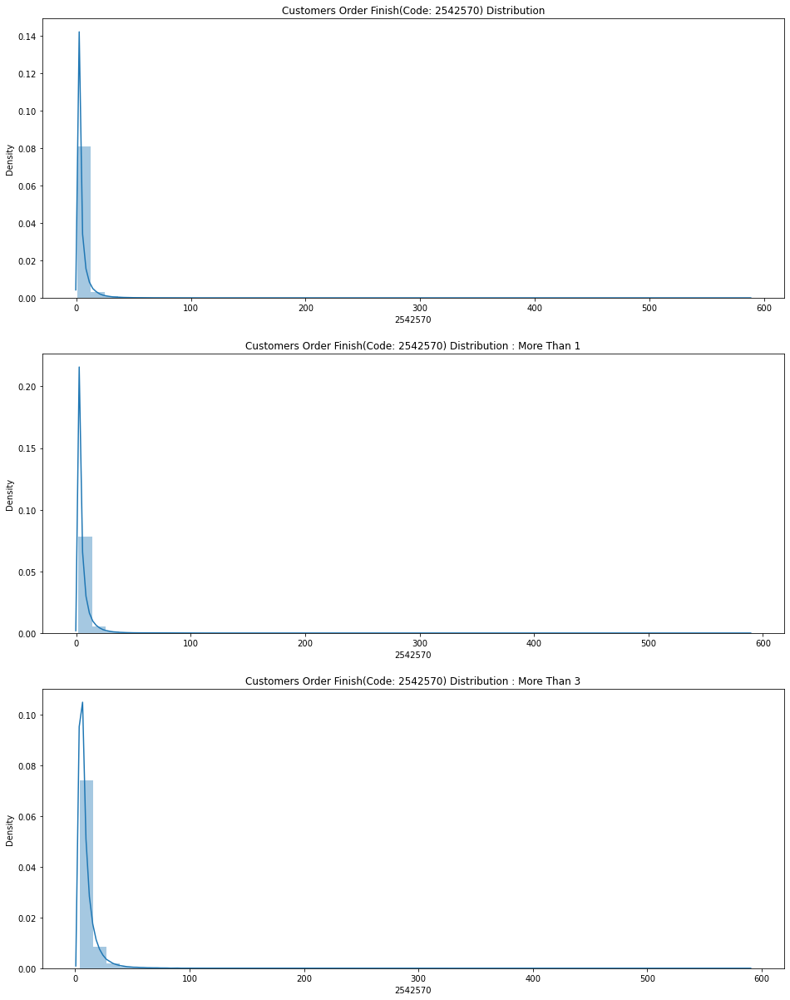

count    280792.000000
mean          3.491321
std           6.470303
min           1.000000
25%           1.000000
50%           1.000000
75%           3.000000
max         587.000000
Name: 2542570, dtype: float64

In [18]:
### Distribution of "Order Finish"(Code: 2542570)

fig, ax = plt.subplots(3, 1, figsize=(16, 21))
sns.distplot(df_bhr_pvt.loc[:, 2542570], ax=ax[0])
ax[0].set_title('Customers Order'' Finish(Code: 2542570) Distribution')
sns.distplot(df_bhr_pvt.loc[df_bhr_pvt.loc[:, 2542570] > 1, 2542570], ax=ax[1])
ax[1].set_title('Customers Order'' Finish(Code: 2542570) Distribution : More Than 1')
sns.distplot(df_bhr_pvt.loc[df_bhr_pvt.loc[:, 2542570] > 3, 2542570], ax=ax[2])
ax[2].set_title('Customers Order'' Finish(Code: 2542570) Distribution : More Than 3')
plt.show()
df_bhr_pvt.loc[:, 2542570].describe()


In [ ]:
# Create Dataset For Clustering
# Due to Memory Size, I Sliced Customers Who Have Order Finish(Code: 2542570) More Than 3

dataset_raw = df_bhr_pvt[df_bhr_pvt.loc[:, 2542570] > 3].copy()


In [20]:
### Stratified Sampling By Order Finish Count

val = dataset_raw.loc[:, 2542570]
val = pd.qcut(val, q=[0, 0.25, 0.5, 0.75, 1], labels=[0, 1, 2, 3])
dataset_raw['stratified'] = val.astype(int)

_, dataset_sample = train_test_split(dataset_raw, test_size=0.15,
                                     stratify=dataset_raw['stratified'],
                                     random_state=2021)

dataset = dataset_sample.values
dataset


array([[ 0,  0, 11, ...,  0,  0,  3],
       [ 0,  1,  3, ...,  0,  0,  0],
       [ 0,  0, 16, ...,  0,  0,  2],
       ...,
       [ 0,  0,  3, ...,  0,  0,  0],
       [ 0,  0,  0, ...,  0,  0,  2],
       [ 0,  0,  4, ...,  0,  0,  0]], dtype=int64)

In [21]:
dataset_raw['stratified'].value_counts()


0    25979
3    15880
2    13765
1    13501
Name: stratified, dtype: int64

In [22]:
dataset_sample['stratified'].value_counts()


0    3897
3    2382
2    2065
1    2025
Name: stratified, dtype: int64

In [23]:
del [[dataset_raw, df, df_agg_cust, df_agg_cust_no, df_agg_of, df_agg_total, df_bhr_pvt, df_no_duplicated]]
gc.collect()
dataset_raw = DataFrame()
df = DataFrame()
df_agg_cust = DataFrame()
df_agg_cust_no = DataFrame()
df_agg_of = DataFrame()
df_agg_total = DataFrame()
df_bhr_pvt = DataFrame()
df_no_duplicated = DataFrame()


# Dendrogram : Cosine Similarity
* Unlike euclidean clustering, it is important to calculate the directions of every customers' behavior tendencies
* Cosine similarity is fittable for find the directions
* The number of cluster is up to you (I choose 7 clusters)

In [24]:
### Linkage Matrix & Dendrogram

data_linkage = sch.linkage(dataset, metric='cosine', method='complete')


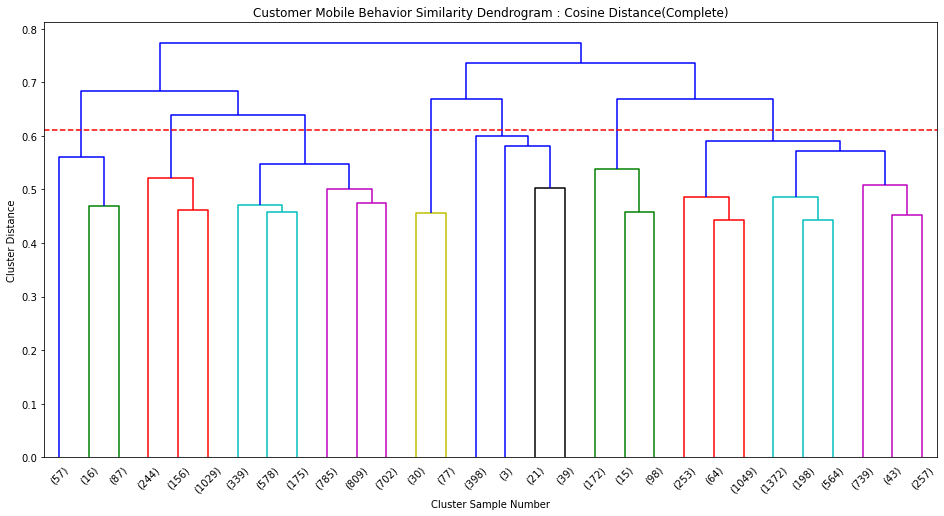

In [28]:
plt.figure(figsize=(16, 8))
data_dend = sch.dendrogram(data_linkage, p=30, truncate_mode='lastp')
plt.title('Customer Mobile Behavior Similarity Dendrogram : Cosine Distance(Complete)')
plt.xlabel('Cluster Sample Number')
plt.ylabel('Cluster Distance')
ax = plt.gca()
bounds = ax.get_xbound()
ax.plot(bounds, [0.61, 0.61], '--', c='r')
plt.show()


# Clustering Result
* Cluster number 1, 2 are major clusters (It takes 76.5% of all customers)

In [29]:
### Make Clusters Into 7 Pieces

cluster_number = sch.cut_tree(data_linkage, 7)
dataset_sample['cluster'] = cluster_number
dataset_sample


bhr_cd,1542568,1542670,1542671,1552569,1552570,1552571,1552573,1552576,1552579,1552581,...,4572573,4582568,4582573,4582575,4592568,4592668,4602568,4602569,stratified,cluster
customer_id,,,,,,,,,,,,,,,,,,,,,
3763768,0,0,11,3,0,2,1,1,0,21,...,0,0,0,0,0,0,0,0,3,0
25767672,0,1,3,1,3,0,0,0,0,4,...,0,0,0,0,0,0,0,0,0,1
39843838,0,0,16,1,5,4,0,0,0,19,...,0,0,0,0,0,0,0,0,2,2
31188352,0,0,6,1,5,2,1,4,1,11,...,0,0,0,0,0,0,0,0,1,1
24011190,0,1,1,0,1,0,0,1,0,3,...,0,0,0,0,0,0,0,0,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31741086,0,0,1,1,1,0,0,2,1,3,...,0,0,0,0,0,0,0,0,0,2
8528655,0,0,8,2,8,2,0,0,3,15,...,0,0,0,0,0,0,0,0,3,1
52273250,0,0,3,1,0,0,0,1,0,7,...,0,0,0,0,0,0,0,0,0,0


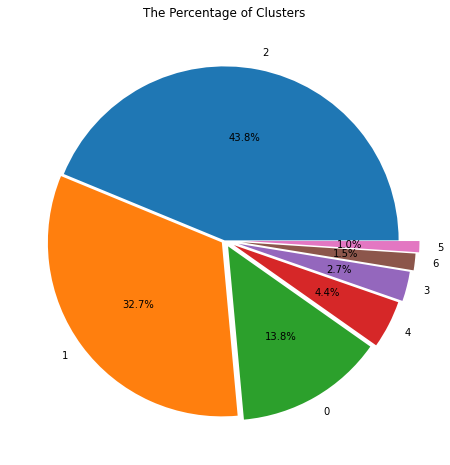

,2,1,0,4,3,6,5
cluster,4539,3388,1429,461,285,160,107


In [30]:
### Make Clusters Into 7 Pieces : Pie Plot

recap = dataset_sample['cluster'].value_counts()
explodes = [ix * 0.02 for ix in range(7)]
plt.figure(figsize=(14, 8))
plt.title('The Percentage of Clusters')
plt.pie(recap, explode=explodes, labels=recap.index, autopct='%1.1f%%')
plt.show()
DataFrame(recap).T


# Clustering Centroid
* In this process, centroids of clusters is
1. Calculate the average of mobile log behaviors in clusters
2. Find the closest point(customer) to the average of mobile log behaviors in clusters

##### Calculate the average of mobile log behaviors in clusters

In [31]:
### Centroids of Clusters

def cosineDist(_array1, _array2):
    _val = np.dot(_array1, _array2) / (np.linalg.norm(_array1, axis=1) * np.linalg.norm(_array2))
    return _val

cols = dataset_sample.columns[:-2].tolist()
centroids_mean = dataset_sample.groupby(['cluster'])[cols].mean()
centroids_mean


bhr_cd,1542568,1542670,1542671,1552569,1552570,1552571,1552573,1552576,1552579,1552581,...,4572568,4572569,4572573,4582568,4582573,4582575,4592568,4592668,4602568,4602569
cluster,,,,,,,,,,,,,,,,,,,,,
0,0.008397,0.777467,7.206438,1.501050,1.715185,0.528341,1.883135,1.208537,0.150455,12.888034,...,0.668999,1.389083,0.023093,0.005598,0.003499,0.002799,0.127362,0.000000,0.000000,0.000000
1,0.007969,0.678276,7.291027,1.312279,4.776269,1.078808,0.951594,2.069362,0.430933,13.211924,...,0.676505,1.436541,0.030992,0.018890,0.008560,0.004723,0.131936,0.000000,0.000885,0.000295
2,0.011016,0.732981,7.024234,1.780568,4.762282,1.711831,0.917603,1.998017,0.773078,14.014100,...,0.961886,1.845561,0.041639,0.022031,0.007931,0.004847,0.132628,0.000220,0.001322,0.000441
3,0.007018,0.901754,3.400000,1.098246,2.343860,0.919298,0.389474,3.028070,0.417544,7.129825,...,0.329825,0.873684,0.035088,0.028070,0.003509,0.000000,0.161404,0.000000,0.003509,0.000000
4,0.008677,1.843818,0.980477,0.360087,1.954447,0.637744,0.117137,1.125813,0.234273,3.843818,...,0.117137,0.475054,0.010846,0.010846,0.006508,0.002169,0.210412,0.000000,0.000000,0.000000
5,0.000000,0.859813,1.588785,0.383178,1.859813,0.392523,0.121495,6.757009,0.102804,6.607477,...,1.672897,2.214953,0.009346,0.018692,0.000000,0.000000,0.093458,0.018692,0.000000,0.000000
6,0.025000,1.112500,8.418750,1.625000,2.881250,0.856250,10.881250,1.275000,0.300000,4.987500,...,0.400000,1.450000,0.025000,0.006250,0.018750,0.000000,0.568750,0.000000,0.000000,0.000000


##### Find the closest point(customer) to the average of mobile log behaviors in clusters

In [32]:
centroids = []

for cluster_num in range(7):
    array = dataset_sample.loc[dataset_sample['cluster'] == cluster_num, cols].copy()
    distances = cosineDist(array.values, centroids_mean.loc[cluster_num])
    array['similarity'] = distances
    array_max = array[array['similarity'] == array['similarity'].max()]
    centroids.append(array_max.iloc[0].values[:-1])

DataFrame(centroids)


,0,1,2,3,4,5,6,7,8,9,...,89,90,91,92,93,94,95,96,97,98
0,0.0,4.0,41.0,9.0,6.0,4.0,19.0,1.0,0.0,69.0,...,0.0,6.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,0.0,1.0,17.0,1.0,11.0,8.0,2.0,6.0,3.0,32.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,6.0,33.0,5.0,21.0,9.0,4.0,5.0,0.0,62.0,...,0.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.0,0.0,4.0,4.0,4.0,0.0,0.0,5.0,0.0,9.0,...,2.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,2.0,2.0,0.0,3.0,0.0,0.0,1.0,0.0,4.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,1.0,0.0,0.0,2.0,1.0,0.0,15.0,0.0,16.0,...,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,11.0,4.0,1.0,0.0,12.0,2.0,0.0,5.0,...,0.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


# Cosine Similarity (From Cluster Centroids to Every Customers)
* Columns "distance_0 to 6" are "Cosine Similarity" to each clusters' controids
* You can assess the result of clustering
    * If customers in cluster 0 are close to the centroid of cluster 9 rather than to the centroid of cluster 0, it is not good clustering

In [33]:
### Calculate Distances From Cluster Centroids

array_data = dataset_sample[cols].values

for cluster_num, cluster_cntr in enumerate(centroids):
    val = cosineDist(array_data, cluster_cntr)
    col = 'distance_{}'.format(cluster_num)
    dataset_sample[col] = val

dataset_sample


bhr_cd,1542568,1542670,1542671,1552569,1552570,1552571,1552573,1552576,1552579,1552581,...,4602569,stratified,cluster,distance_0,distance_1,distance_2,distance_3,distance_4,distance_5,distance_6
customer_id,,,,,,,,,,,,,,,,,,,,,
3763768,0,0,11,3,0,2,1,1,0,21,...,0,3,0,0.941600,0.858472,0.866277,0.792440,0.754752,0.744512,0.725611
25767672,0,1,3,1,3,0,0,0,0,4,...,0,0,1,0.850755,0.873874,0.908157,0.852142,0.930812,0.742053,0.823321
39843838,0,0,16,1,5,4,0,0,0,19,...,0,2,2,0.837343,0.903022,0.923031,0.827928,0.739104,0.625158,0.748192
31188352,0,0,6,1,5,2,1,4,1,11,...,0,1,1,0.870670,0.935506,0.923998,0.855441,0.842496,0.686648,0.773599
24011190,0,1,1,0,1,0,0,1,0,3,...,0,0,3,0.804661,0.835180,0.844149,0.859633,0.804315,0.683086,0.743271
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31741086,0,0,1,1,1,0,0,2,1,3,...,0,0,2,0.756384,0.828690,0.837421,0.853727,0.884422,0.767218,0.763871
8528655,0,0,8,2,8,2,0,0,3,15,...,0,3,1,0.864124,0.915159,0.945960,0.925810,0.819516,0.721372,0.794226
52273250,0,0,3,1,0,0,0,1,0,7,...,0,0,0,0.886174,0.856200,0.821946,0.779171,0.735230,0.614597,0.713445


In [37]:
### Heatmap : Similarity to Centroids

cols = ['distance_' + str(ix) for ix in range(7)]
df_heat = dataset_sample.set_index(['cluster'])[cols].copy()


In [40]:
val_max = df_heat.max(axis=1)

for ix in cols:
    df_heat[ix] = df_heat[ix] / val_max


In [41]:
df_heat


bhr_cd,distance_0,distance_1,distance_2,distance_3,distance_4,distance_5,distance_6
cluster,,,,,,,
0,1.000000,0.911716,0.920005,0.841589,0.801563,0.790688,0.770615
1,0.913992,0.938830,0.975661,0.915483,1.000000,0.797210,0.884519
2,0.907167,0.978322,1.000000,0.896967,0.800736,0.677288,0.810581
1,0.930694,1.000000,0.987699,0.914415,0.900578,0.733986,0.826930
3,0.936053,0.971554,0.981988,1.000000,0.935650,0.794625,0.864637
...,...,...,...,...,...,...,...
2,0.855230,0.936985,0.946858,0.965294,1.000000,0.867479,0.863695
1,0.913488,0.967439,1.000000,0.978699,0.866332,0.762581,0.839598
0,1.000000,0.966177,0.927523,0.879253,0.829668,0.693540,0.805085


# Cosine Similarity : Heat Map
* Customers in cluster 1, 2 are very close each other
* Cluster 0, 3, 4, 5, 6 have their own traits in mobile log behaviors
* Cluster 5 is heterogeneous cluster compared to other clusters
<br/><br/>
* In terms of deploying the cluster model in the business situation, it is necessary to make a meta model (Supervised ML) with dataset includes cluster flag

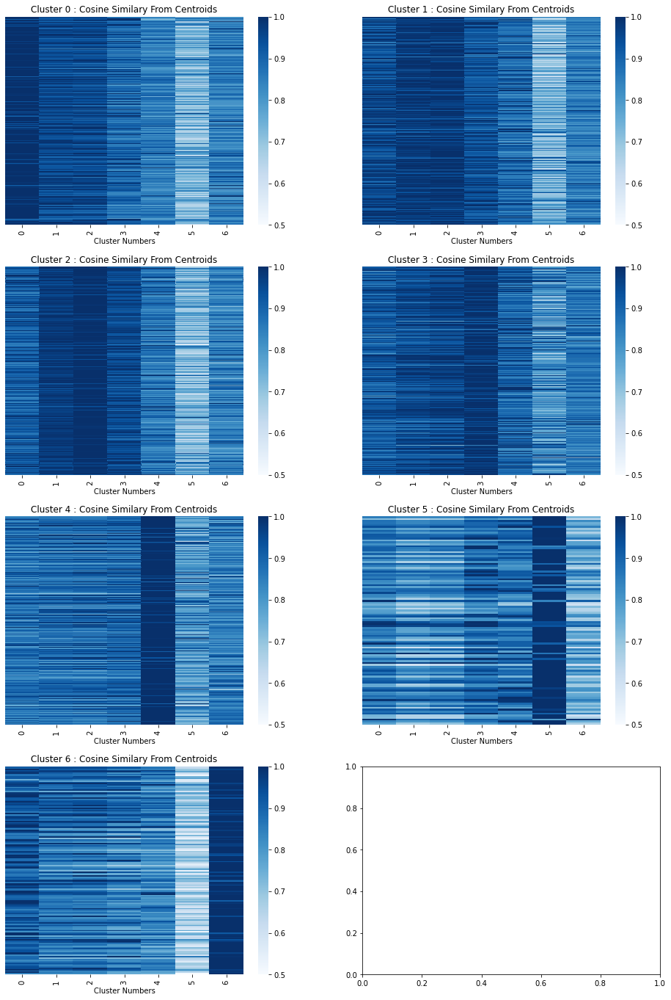

In [59]:
ix = 0
fig, ax = plt.subplots(4, 2, figsize=(8 * 2, 6 * 4))

for ix1 in range(4):
    for ix2 in range(2):
        try:
            sns.heatmap(df_heat.loc[ix], vmax=1, vmin=0.5, cmap='Blues', yticklabels=False, ax=ax[ix1,ix2])
            ax[ix1,ix2].set_title('Cluster {} : Cosine Similary From Centroids'.format(ix))
            ax[ix1,ix2].set_xticks([ix_num + .5 for ix_num in range(7)])
            ax[ix1,ix2].set_xticklabels(list(range(7)))
            ax[ix1,ix2].set_xlabel('Cluster Numbers')
            ax[ix1,ix2].set_ylabel('')
        except:
            pass
        ix += 1

plt.show()
